In [1]:
import pandas as pd    
import TFvelo.TFvelo as TFv
import anndata as ad
import numpy as np
import scanpy as sc
import scvelo as scv
import matplotlib
#matplotlib.use('AGG')
import os, sys
import scipy
np.set_printoptions(suppress=True)


In [2]:
result_path = 'TFvelo_revealing/'
os.makedirs(result_path, exist_ok=True)
n_jobs=32
adata = ad.read_h5ad('datasets/human_cd34_bone_marrow.h5ad')
adata

AnnData object with n_obs × n_vars = 5780 × 14319
    obs: 'clusters', 'palantir_pseudotime'
    uns: 'clusters_colors'
    obsm: 'X_tsne'
    layers: 'spliced', 'unspliced'

In [3]:
from importlib import reload
# reload(TFv)

<module 'TFvelo.TFvelo' from '/home/qukungroup/syuqiao22/intracurricular/BioSysModel/project/TFvelo/TFvelo/__init__.py'>

In [6]:
def preprocess(adata, TF_databases='ENCODE ChEA', n_neighbors=30):
    if not adata:
        adata = scv.datasets.pancreas() 
        # elif args.dataset_name == 'gastrulation_erythroid':
        #     adata = scv.datasets.gastrulation_erythroid()   
        #     adata.uns['clusters_colors'] = adata.uns['celltype_colors'].copy()
        #     adata.obs['clusters'] = adata.obs['celltype'].copy()
        # elif args.dataset_name == 'hesc1':
        #     expression = pd.read_table("data/hesc1/rpkm.txt", header=0, index_col=0, sep="\t").T 
        #     adata = ad.AnnData(expression)
        #     adata.obs_names = expression.index
        #     adata.var_names = expression.columns
        #     adata.obs['time_gt'] = 'Nan'
        #     for ii, cell in enumerate(adata.obs_names):
        #         adata.obs['time_gt'][ii] = cell.split('.')[0]
        #     adata.obs['time_gt'] = adata.obs['time_gt'].astype('category') 
        #     adata.obs['clusters'] = adata.obs['time_gt'].copy()
        # elif args.dataset_name == '10x_mouse_brain':
        #     adata = ad.read_h5ad("data/10x_mouse_brain/adata_rna.h5ad")  
        #     adata.obs['clusters'] = adata.obs['celltype'].copy()   

    # if not os.path.exists(args.result_path):
    #     os.makedirs(args.result_path)
    adata.var_names_make_unique()
    adata.obs_names_make_unique()

    adata.uns['genes_all'] = np.array(adata.var_names)

    if "spliced" in adata.layers:
        adata.layers["total"] = adata.layers["spliced"].todense() + adata.layers["unspliced"].todense()
    elif "new" in adata.layers:
        adata.layers["total"] = np.array(adata.layers["total"].todense())
    else:
        adata.layers["total"] = adata.X
    adata.layers["total_raw"] = adata.layers["total"].copy()
    n_cells, n_genes = adata.X.shape
    sc.pp.filter_genes(adata, min_cells=int(n_cells/50))
    sc.pp.filter_cells(adata, min_genes=int(n_genes/50))
    TFv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000, log=True) #include the following steps
    adata.X = adata.layers["total"].copy()

    # if not args.dataset_name in ['10x_mouse_brain']:
    #     adata.uns['clusters_colors'] = np.array(['red', 'orange', 'yellow', 'green','skyblue', 'blue','purple', 'pink', '#8fbc8f', '#f4a460', '#fdbf6f', '#ff7f00', '#b2df8a', '#1f78b4',
    #         '#6a3d9a', '#cab2d6'], dtype=object)

    gene_names = []
    for tmp in adata.var_names:
        gene_names.append(tmp.upper())
    adata.var_names = gene_names
    adata.var_names_make_unique()
    adata.obs_names_make_unique()

    TFv.pp.moments(adata, n_pcs=30, n_neighbors=n_neighbors)

    TFv.pp.get_TFs(adata, databases=TF_databases)
    print(adata)
    adata.uns['genes_pp'] = np.array(adata.var_names)

    return adata

adata1 = preprocess(None, )
adata1

Normalized count data: X, spliced, unspliced, total.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'M_total', moments of total abundances (adata.layers)
Get TFs according to ENCODE ChEA
/home/qukungroup/syuqiao22/intracurricular/BioSysModel/project
max_n_TF: 29
mean_n_TF: 12.3345
gene num of 0 TF: 109
total num of TFs: 46
AnnData object with n_obs × n_vars = 3696 × 2000
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'genes_a

AnnData object with n_obs × n_vars = 3696 × 2000
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'genes_all', 'all_TFs', 'genes_pp'
    obsm: 'X_pca', 'X_umap'
    varm: 'TFs', 'TFs_id', 'TFs_times', 'TFs_correlation', 'knockTF_Log2FC'
    layers: 'spliced', 'unspliced', 'total', 'total_raw', 'M_total'
    obsp: 'distances', 'connectivities'

In [32]:
adata1.var['highly_variable_genes'].value_counts()

True     1494
False     506
Name: highly_variable_genes, dtype: int64

In [44]:
adata2 = adata1[:, np.sum(np.abs(adata1.varm['TFs_correlation']), axis=1) > 0]
adata2

View of AnnData object with n_obs × n_vars = 3696 × 1869
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'genes_all', 'all_TFs', 'genes_pp'
    obsm: 'X_pca', 'X_umap'
    varm: 'TFs', 'TFs_id', 'TFs_times', 'TFs_correlation', 'knockTF_Log2FC'
    layers: 'spliced', 'unspliced', 'total', 'total_raw', 'M_total'
    obsp: 'distances', 'connectivities'

In [45]:
adata2.uns['all_TFs']

['EGR1',
 'FOXA2',
 'ATF3',
 'REST',
 'MXI1',
 'E2F1',
 'MAFF',
 'FOXP2',
 'SRF',
 'FOS',
 'BACH1',
 'STAT3',
 'HMGN3',
 'MEF2A',
 'JUND',
 'FOXP1',
 'EZH2',
 'SOX9',
 'KLF2',
 'KLF4',
 'PRDM16',
 'CHD7',
 'NR4A2',
 'VDR',
 'CDX2',
 'FOXO1',
 'RCOR2',
 'NFIB',
 'PDX1',
 'FOXO3',
 'AUTS2',
 'PAX6',
 'JARID2',
 'SOX11',
 'ISL1',
 'DACH1',
 'NEUROD2',
 'POU3F1',
 'MNX1',
 'SMC4',
 'ETV1',
 'RAC3',
 'KLF6',
 'BCOR',
 'CCND1',
 'CREM']

In [61]:
np.sum(adata2.var['highly_variable_genes'] == 'True')

1411

In [64]:
# adata3 = adata2[:, (adata2.var_names.isin(adata2.uns['all_TFs'])) | (adata2.var['highly_variable_genes'] == 'True')]
# adata3

View of AnnData object with n_obs × n_vars = 3696 × 1420
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'genes_all', 'all_TFs', 'genes_pp'
    obsm: 'X_pca', 'X_umap'
    varm: 'TFs', 'TFs_id', 'TFs_times', 'TFs_correlation', 'knockTF_Log2FC'
    layers: 'spliced', 'unspliced', 'total', 'total_raw', 'M_total'
    obsp: 'distances', 'connectivities'

In [65]:
# sc.pp.subsample(adata3, fraction=0.5)

In [67]:
# sc.pp.subsample(adata1, fraction=0.5)

In [70]:
TFv.tl.recover_dynamics(adata1, n_jobs=n_jobs, max_iter=20, var_names='all',
        WX_method='lsq_linear', WX_thres=20, max_n_TF=99, n_top_genes=2000,
        fit_scaling=True, use_raw=0, init_weight_method="correlation", 
        n_time_points=1000) 

adata1.write(result_path + 'rc.h5ad')

recovering dynamics (using 7/192 cores)
Processing 0/143 UCHL1
0/143 UCHL1 FINISHED with n_TFs: 13
Processing 1/143 SMAP2
1/143 SMAP2 FINISHED with n_TFs: 17
Processing 2/143 MCMBP
2/143 MCMBP FINISHED with n_TFs: 17
Processing 3/143 SMC4
3/143 SMC4 FINISHED with n_TFs: 15
Processing 4/143 ZFP516
4/143 ZFP516 FINISHED with n_TFs: 7
Processing 5/143 DCAF6
5/143 DCAF6 FINISHED with n_TFs: 22
Processing 6/143 BCOR
6/143 BCOR FINISHED with n_TFs: 18
BC048546 not recoverable due to n_TFs = 0
Processing 8/143 1500009L16RIK
8/143 1500009L16RIK FINISHED with n_TFs: 6
Processing 9/143 TYMS
9/143 TYMS FINISHED with n_TFs: 12
Processing 10/143 AMOTL2
10/143 AMOTL2 FINISHED with n_TFs: 18
Processing 11/143 ARX
11/143 ARX FINISHED with n_TFs: 15
Processing 12/143 BST2
12/143 BST2 FINISHED with n_TFs: 16
Processing 13/143 CHIC1
13/143 CHIC1 FINISHED with n_TFs: 9
Processing 14/143 PCDH9
14/143 PCDH9 FINISHED with n_TFs: 14
Processing 15/143 PEA15A
15/143 PEA15A FINISHED with n_TFs: 6
Processing 16/1

In [71]:
adata1.write(result_path + 'rc.h5ad')
losses = adata1.varm['loss'].copy()
losses[np.isnan(losses)] = 1e6
adata1.var['min_loss'] = losses.min(1)

n_cells = adata1.shape[0]
expanded_scaling_y = np.expand_dims(np.array(adata1.var['fit_scaling_y']),0).repeat(n_cells,axis=0)
adata1.layers['velocity'] = adata1.layers['velo_hat'] / expanded_scaling_y  

In [74]:
adata1

AnnData object with n_obs × n_vars = 1848 × 2000
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs', 'fit_alpha', 'fit_beta', 'fit_omega', 'fit_theta', 'fit_gamma', 'fit_delta', 'fit_likelihood', 'fit_varx', 'fit_scaling_y', 'min_loss'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'genes_all', 'all_TFs', 'genes_pp', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'TFs', 'TFs_id', 'TFs_times', 'TFs_correlation', 'knockTF_Log2FC', 'fit_scaling', 'fit_weights', 'fit_weights_init', 'fit_weights_final', 'loss'
    layers: 'spliced', 'unspliced', 'total

In [233]:
adata1.layers['velocity']

array([[-0.466404  ,         nan, -1.48361472, ..., -0.32724159,
        -1.0069339 ,  1.16574026],
       [ 1.16731198,         nan, -1.23508375, ..., -4.09401432,
         0.94065439, -0.92575983],
       [ 1.33245311,         nan, -0.25018211, ..., -3.13068691,
         0.97559476, -1.08868247],
       ...,
       [ 1.36446922,         nan,  0.96393749, ..., -3.98658902,
         0.9124536 , -1.08872883],
       [-0.86949622,         nan,  2.47487022, ..., 11.88277803,
        -0.93941243,  0.99188847],
       [ 1.40005546,         nan, -1.08264296, ..., -3.49326413,
         0.91208814, -1.03010246]])

In [81]:
from importlib import reload
reload(matplotlib)

<module 'matplotlib' from '/home/qukungroup/syuqiao22/miniconda3/envs/P38C_TFvelo/lib/python3.8/site-packages/matplotlib/__init__.py'>

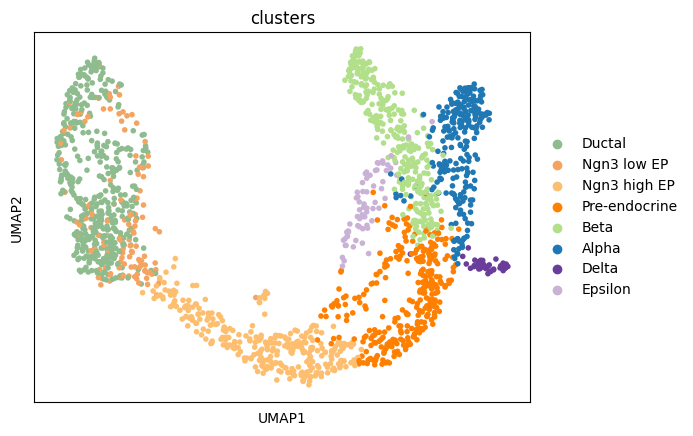

In [83]:
sc.pl.umap(adata1, color='clusters')

or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 1/192 cores)
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


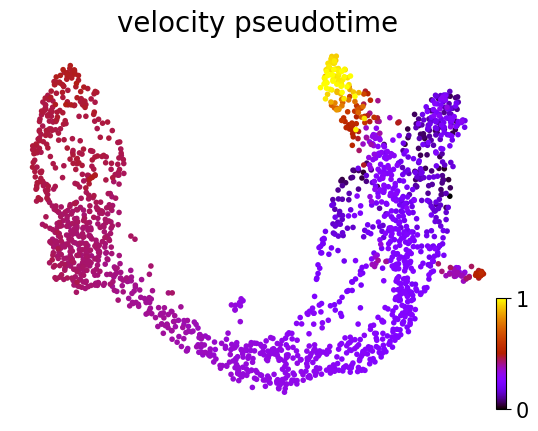

In [84]:
def get_pseudotime(adata):
    TFv.tl.velocity_graph(adata, basis=None, vkey='velocity', xkey='M_total')
    TFv.tl.velocity_pseudotime(adata, vkey='velocity', modality='M_total') 
    TFv.pl.scatter(adata, basis='umap', color='velocity_pseudotime', cmap='gnuplot', fontsize=20)#, save='pseudotime')
    return adata

adata1 = get_pseudotime(adata1)

In [85]:
def data_type_tostr(adata, key=None):
    if key is None:
        for key in list(adata.var):
            if adata.var[key][0] in [True, False]:
                print('Transfering', key)
                adata.var[key] = adata.var[key].map({True: 'True', False:'False'})
    elif key in adata.var.keys():
        if adata.var[key][0] in [True, False]:
            print('Transfering', key)
            adata.var[key] = adata.var[key].map({True: 'True', False:'False'})
    return   

def get_sort_positions(arr):
    positions = np.argsort(np.argsort(arr))
    positions_normed = positions/(len(arr)-1)
    return positions_normed


def get_sort_t(adata):
    t = adata.layers['fit_t_raw'].copy()
    normed_t = adata.layers['fit_t_raw'].copy()
    n_bins = 20
    n_cells, n_genes = adata.shape
    sort_t = np.zeros([n_cells, n_genes])
    non_blank_gene = np.zeros(n_genes, dtype=int)
    hist_all, bins_all = np.zeros([n_genes, n_bins]), np.zeros([n_genes, n_bins+1])
    for i in range(n_genes):
        gene_name = adata.var_names[i]
        tmp = t[:,i].copy()
        if np.isnan(tmp).sum():
            non_blank_gene[i] = 1 
            continue
        hist, bins = np.histogram(tmp, bins=n_bins)
        hist_all[i], bins_all[i] = hist, bins
        if not (0 in list(hist)):
            if (tmp.min() < 0.1) and (tmp.max() > 0.8):
                blank_start_bin_id = np.argmin(hist)
                blank_end_bin_id = blank_start_bin_id
                non_blank_gene[i] = 1
                blank_start_bin = bins[blank_start_bin_id]
                blank_end_bin = bins[blank_end_bin_id]
                tmp = (tmp < blank_start_bin)*1 + tmp 
            else:
                blank_end_bin = tmp.min()
        else:
            blank_start_bin_id = list(hist).index(0)
            for j in range(blank_start_bin_id+1, len(hist)):
                if hist[j] > 0:
                    blank_end_bin_id = j
                    break
            blank_start_bin = bins[blank_start_bin_id]
            blank_end_bin = bins[blank_end_bin_id]
            tmp = (tmp < blank_start_bin)*1 + tmp 
            
        t[:,i] = tmp
        tmp = tmp - blank_end_bin
        tmp = tmp/tmp.max()
        normed_t[:,i] = tmp
        sort_t[:,i] = get_sort_positions(tmp)

    adata.layers['latent_t'] = sort_t.copy() 
    adata.var['non_blank_gene'] = non_blank_gene.copy()
    return adata



adata_copy = adata1.copy()
adata_copy = get_sort_t(adata_copy) 

adata_copy_1 = adata_copy.copy()
data_type_tostr(adata_copy_1)
print(adata_copy_1)
adata_copy_1.write(result_path + 'rc.h5ad')

Transfering highly_variable
Transfering non_blank_gene
AnnData object with n_obs × n_vars = 1848 × 2000
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs', 'fit_alpha', 'fit_beta', 'fit_omega', 'fit_theta', 'fit_gamma', 'fit_delta', 'fit_likelihood', 'fit_varx', 'fit_scaling_y', 'min_loss', 'non_blank_gene'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'genes_all', 'all_TFs', 'genes_pp', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'TFs', 'TFs_id', 'TFs_times', 'TFs_correlation', 'knockTF_Log2FC', 'fit_scaling', 'fit_weights', 'fit_weights_init

In [234]:
adata_copy_1.layers['velocity']

array([[-0.466404  ,         nan, -1.48361472, ..., -0.32724159,
        -1.0069339 ,  1.16574026],
       [ 1.16731198,         nan, -1.23508375, ..., -4.09401432,
         0.94065439, -0.92575983],
       [ 1.33245311,         nan, -0.25018211, ..., -3.13068691,
         0.97559476, -1.08868247],
       ...,
       [ 1.36446922,         nan,  0.96393749, ..., -3.98658902,
         0.9124536 , -1.08872883],
       [-0.86949622,         nan,  2.47487022, ..., 11.88277803,
        -0.93941243,  0.99188847],
       [ 1.40005546,         nan, -1.08264296, ..., -3.49326413,
         0.91208814, -1.03010246]])

In [274]:
def check_data_type(adata):
    for key in list(adata.var):
        if adata.var[key][0] in ['True', 'False']:
            print('Checking', key)
            adata.var[key] = adata.var[key].map({'True': True, 'False': False})
    return

adata_copy = ad.read_h5ad(result_path + 'rc.h5ad')
check_data_type(adata_copy)

Checking highly_variable_genes
Checking highly_variable
Checking non_blank_gene


In [275]:
adata_copy.layers['velocity'].shape

(1848, 2000)

In [276]:
np.sum(adata_copy.var['non_blank_gene'] == True)

1242

In [277]:
def get_metric_pseudotime(adata, t_key='latent_t'):
    n_cells, n_genes = adata.shape
    adata.var['spearmanr_pseudotime'] = 0.0
    for i in range(n_genes):
        correlation, _ = scipy.stats.spearmanr(adata.layers[t_key][:,i], adata.obs['velocity_pseudotime'])
        adata.var['spearmanr_pseudotime'][i] = correlation
    return adata

loss_percent_thres = 80
spearmanr_thres = 0.8

thres_loss = np.percentile(adata_copy.var['min_loss'], loss_percent_thres) 
adata_copy = adata_copy[:, adata_copy.var['min_loss'] < thres_loss]

print(adata_copy.shape)

thres_n_cells = adata_copy.X.shape[0] * 0.1
adata_copy = adata_copy[:, adata_copy.var['n_cells'] > thres_n_cells]

print(adata_copy.shape)

adata_copy = adata_copy[:, adata_copy.var['non_blank_gene']==0] 

print(adata_copy.shape)

adata_copy = get_metric_pseudotime(adata_copy)
adata_copy = adata_copy[:, adata_copy.var['spearmanr_pseudotime'] > spearmanr_thres] 

print(adata_copy.shape)
adata_copy.layers['velocity']

(1848, 977)
(1848, 957)
(1848, 741)
(1848, 17)


ArrayView([[ 30.18858351,   1.57088933,   2.21007335, ...,   2.48678564,
              3.91462617,   2.16862956],
           [ -7.46724421, -10.19306648,  -1.74889724, ...,  -0.97966335,
             -2.8159174 ,  -0.43628599],
           [ -0.91370506,  -4.6392848 ,  -1.64404816, ...,  -1.7469843 ,
             -2.24748462,  -2.1453569 ],
           ...,
           [  0.17416131,  -9.1640416 ,  -1.96618525, ...,  -1.95479712,
             -2.39509944,  -1.78967415],
           [ 37.78376904,   1.85650382,   1.88899308, ...,   2.10837065,
              4.74203306,   2.00847582],
           [  3.67364496,   0.46964166,  -0.59643609, ...,  -0.70037684,
             -0.99064851,  -0.91940898]])

In [278]:
adata_copy.shape

(1848, 17)

In [92]:
# sc.pp.neighbors(adata1, **adata1.uns['neighbors']['params'])

In [124]:
# importlib.util.spec_from_file_location("velocity_graph", 'TFvelo/TFvelo/tools/velocity_graph.py')

ModuleSpec(name='velocity_graph', loader=<_frozen_importlib_external.SourceFileLoader object at 0x14cff88cc8b0>, origin='TFvelo/TFvelo/tools/velocity_graph.py')

In [136]:
# "TFvelo.TFvelo.tools.velocity_graph" in sys.modules

True

In [227]:
# spec = importlib.util.spec_from_file_location("TFvelo.TFvelo.tools.velocity_graph", 'TFvelo/TFvelo/tools/velocity_graph.py')
# velocity_graph_module = importlib.util.module_from_spec(spec)
# sys.modules["TFvelo.TFvelo.tools.velocity_graph"] = velocity_graph_module
# spec.loader.exec_module(velocity_graph_module)

# reload(TFv.tools)
# reload(velocity_graph_module)

<module 'TFvelo.TFvelo.tools.velocity_graph' from '/home/qukungroup/syuqiao22/intracurricular/BioSysModel/project/TFvelo/TFvelo/tools/velocity_graph.py'>

In [228]:
# vgraph = velocity_graph_module.VelocityGraph(adata_copy, vkey='velocity', xkey='M_total')

[[  1.5708894 ]
 [-10.193067  ]
 [ -4.6392846 ]
 ...
 [ -9.1640415 ]
 [  1.8565038 ]
 [  0.46964166]]


In [220]:
# vgraph.compute_cosines(n_jobs=1)

DEBUG: _compute_cosines 被调用，参数 obs_idx=[   0    1    2 ... 1845 1846 1847], 类型=<class 'numpy.ndarray'>
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0.]
[0

ValueError: need at least one array to concatenate

In [230]:
adata_copy.layers['velocity']

ArrayView([[  1.57088933],
           [-10.19306648],
           [ -4.6392848 ],
           ...,
           [ -9.1640416 ],
           [  1.85650382],
           [  0.46964166]])

or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 1/192 cores)
    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


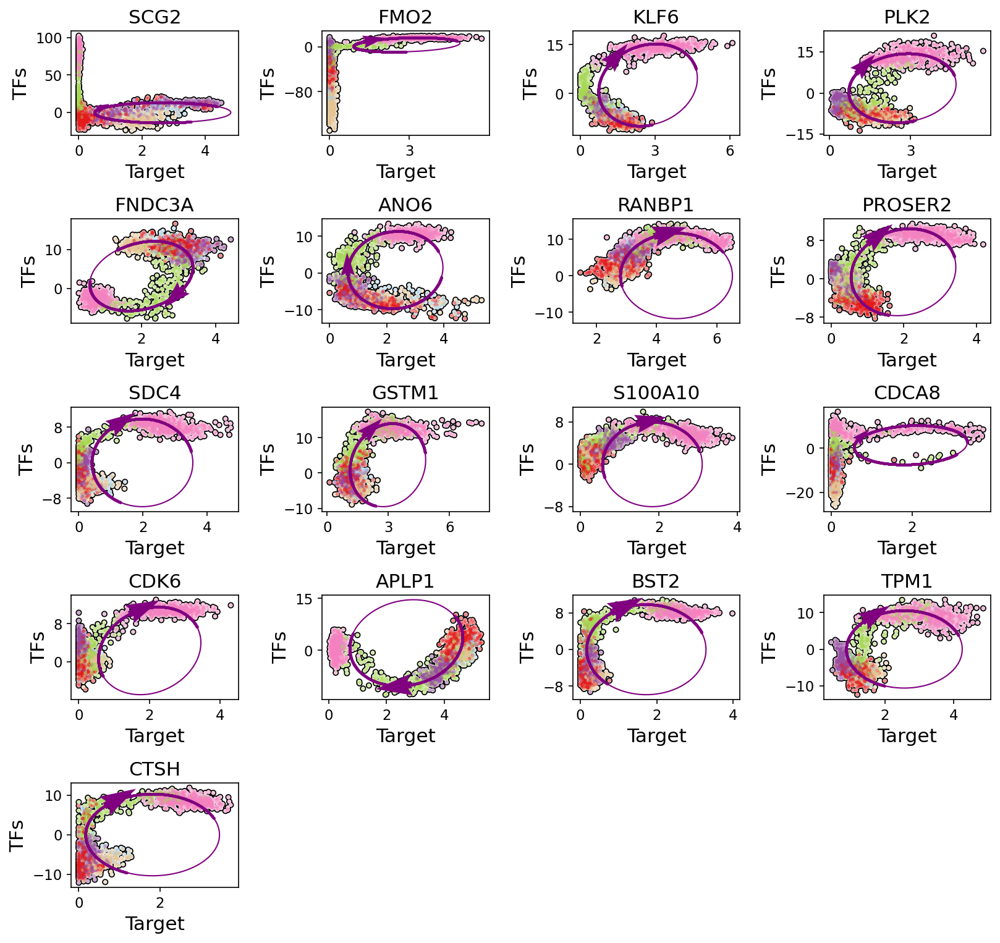

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


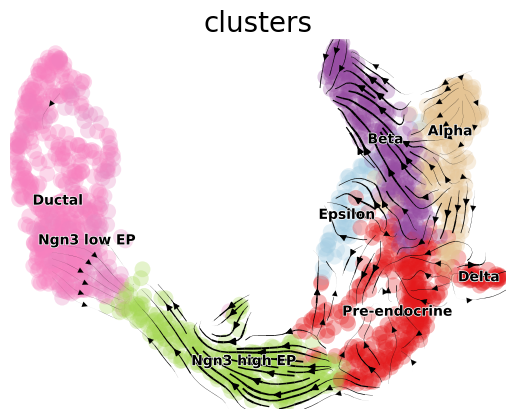

Transfering highly_variable_genes
Transfering highly_variable
Transfering non_blank_gene
AnnData object with n_obs × n_vars = 1848 × 17
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs', 'fit_alpha', 'fit_beta', 'fit_omega', 'fit_theta', 'fit_gamma', 'fit_delta', 'fit_likelihood', 'fit_varx', 'fit_scaling_y', 'min_loss', 'non_blank_gene', 'spearmanr_pseudotime'
    uns: 'all_TFs', 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'genes_all', 'genes_pp', 'neighbors', 'pca', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap', 'velocity_umap'
    varm: 'TFs', 'TFs_correlation', 'TFs_id', 'TFs_

In [279]:

def show_adata(adata, save_name, show_all=0):
    if show_all:
        for i in range(int((len(adata.var_names)-1)/20)+1):
            genes2show = adata.var_names[i*20: (i+1)*20]
            TFv.pl.velocity(adata, genes2show, ncols=4, add_outline=True, layers='na', dpi=150, fontsize=15)#, save='WX_y_'+save_name+'_'+str(i)) #layers='all'
    if len(adata.obs['clusters'].cat.categories) > 10:
        legend_loc = 'right margin'
    else:
        legend_loc = 'on data'
    cutoff_perc = 20
    TFv.pl.velocity_embedding_stream(adata, vkey='velocity', use_derivative=False, density=2, basis='umap', \
        cutoff_perc=cutoff_perc, smooth=0.5, fontsize=20, recompute=True, \
        legend_loc=legend_loc)#, save='embedding_stream_'+save_name) # 

    return

TFv.tl.velocity_graph(adata_copy, basis=None, vkey='velocity', xkey='M_total')
adata_copy.uns['clusters_colors'] = adata.uns['clusters_colors']
show_adata(adata_copy, save_name='velo', show_all=1)


data_type_tostr(adata_copy)
print(adata_copy)
adata_copy.write(result_path + 'TFvelo.h5ad')

In [232]:
'velocity_genes' in adata_copy.var.columns

False

In [321]:
adata_copy2 = sc.read_h5ad(result_path + 'TFvelo.h5ad')
adata_copy2

AnnData object with n_obs × n_vars = 3696 × 284
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size_total', 'initial_size', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'highly_variable_genes', 'n_cells', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'n_TFs', 'fit_alpha', 'fit_beta', 'fit_omega', 'fit_theta', 'fit_gamma', 'fit_delta', 'fit_likelihood', 'fit_varx', 'fit_scaling_y', 'min_loss', 'non_blank_gene', 'spearmanr_pseudotime'
    uns: 'all_TFs', 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'genes_all', 'genes_pp', 'neighbors', 'pca', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap', 'velocity_umap'
    varm: 'TFs', 'TFs_correlation', 'TFs_id', 'TFs_times', 'fit_scaling', 'fit_weights', 'fit_weights_final', 'fit_weights_init', 'knockTF_

computing velocity graph (using 1/192 cores)
    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


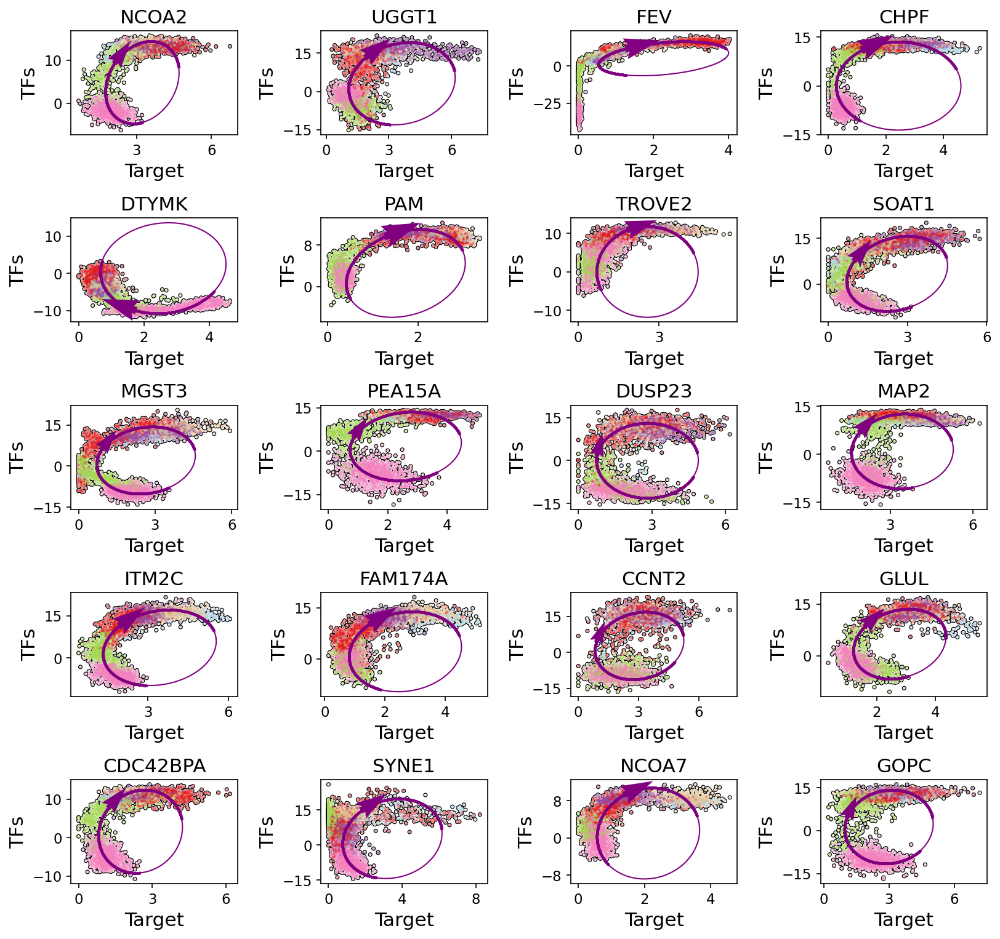

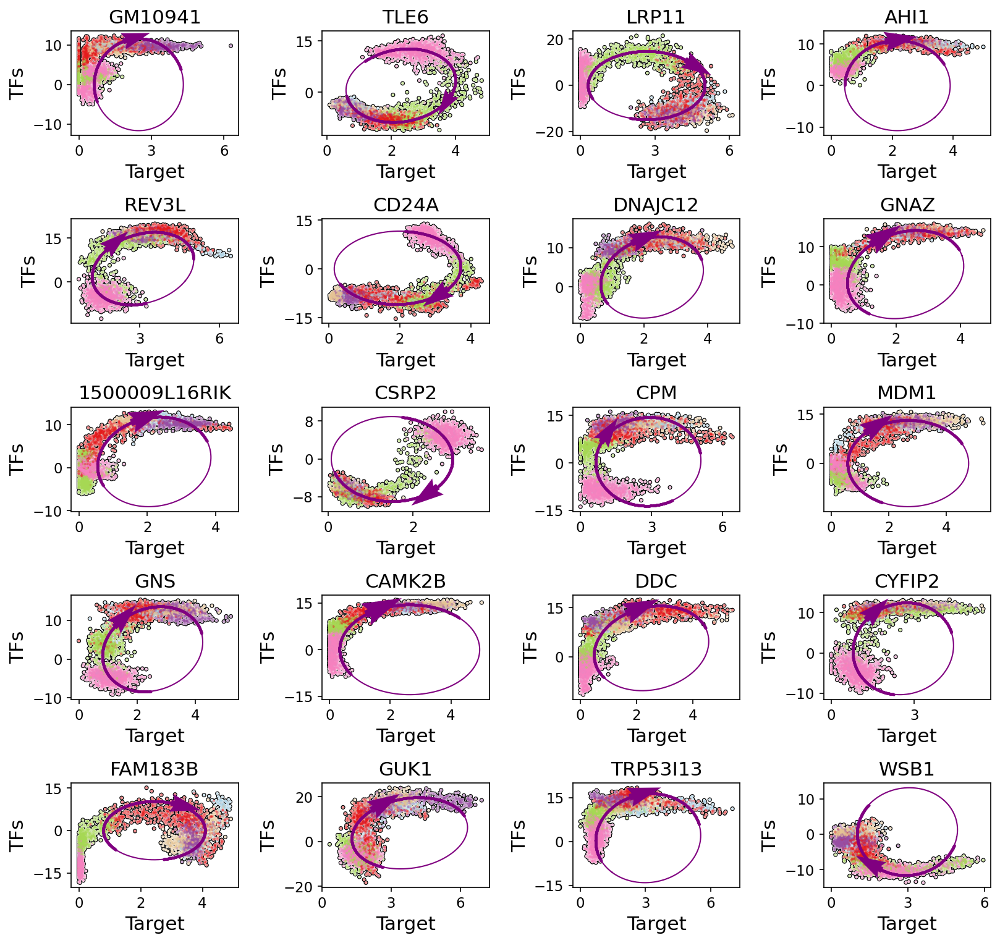

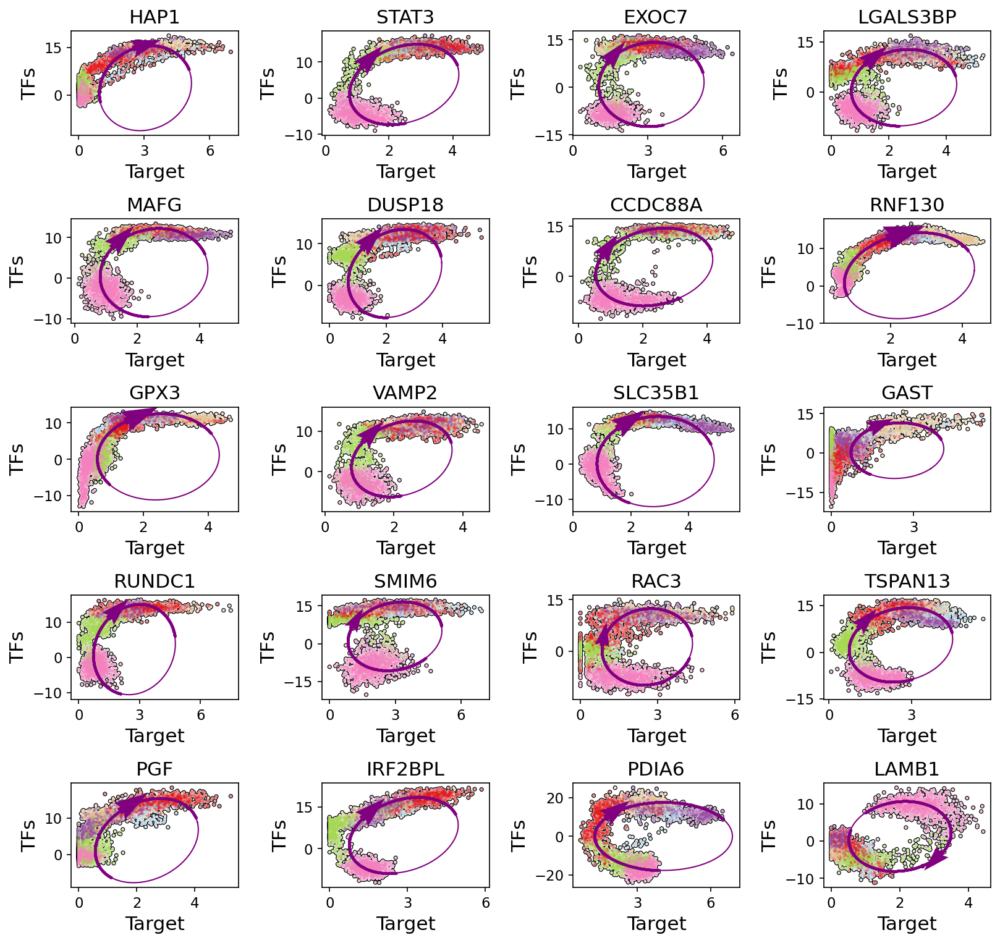

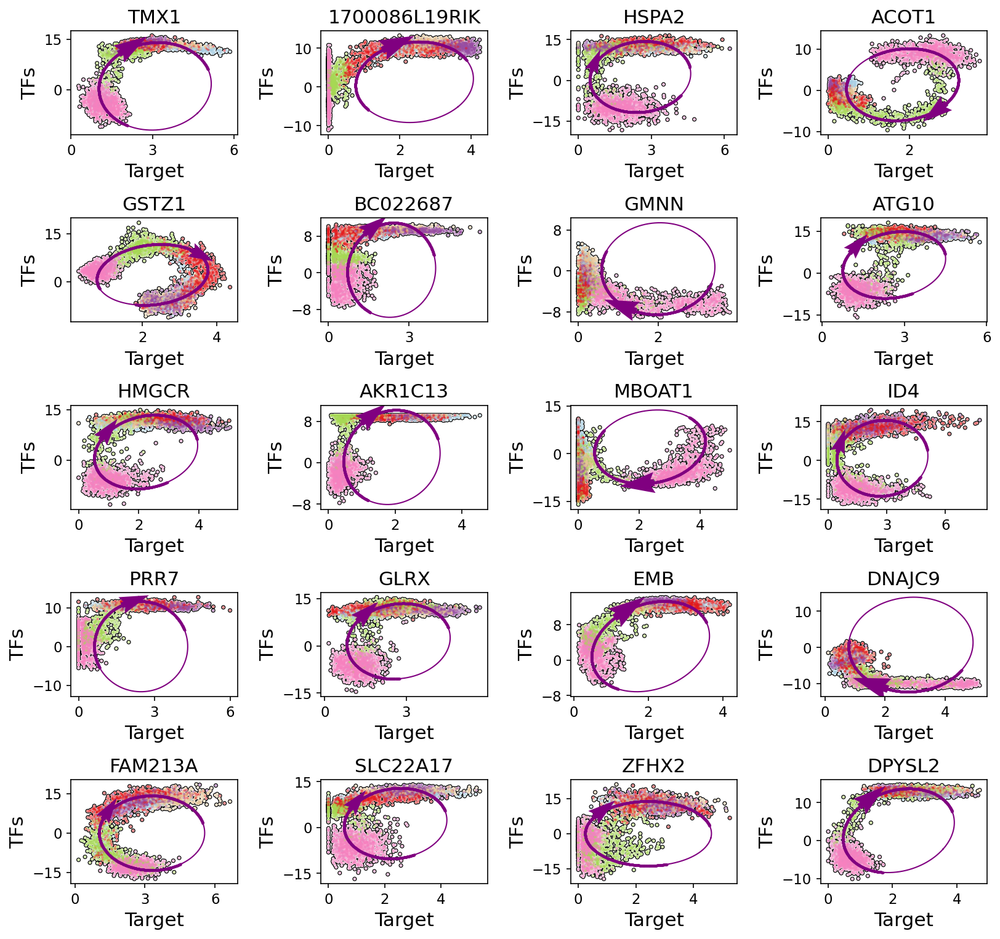

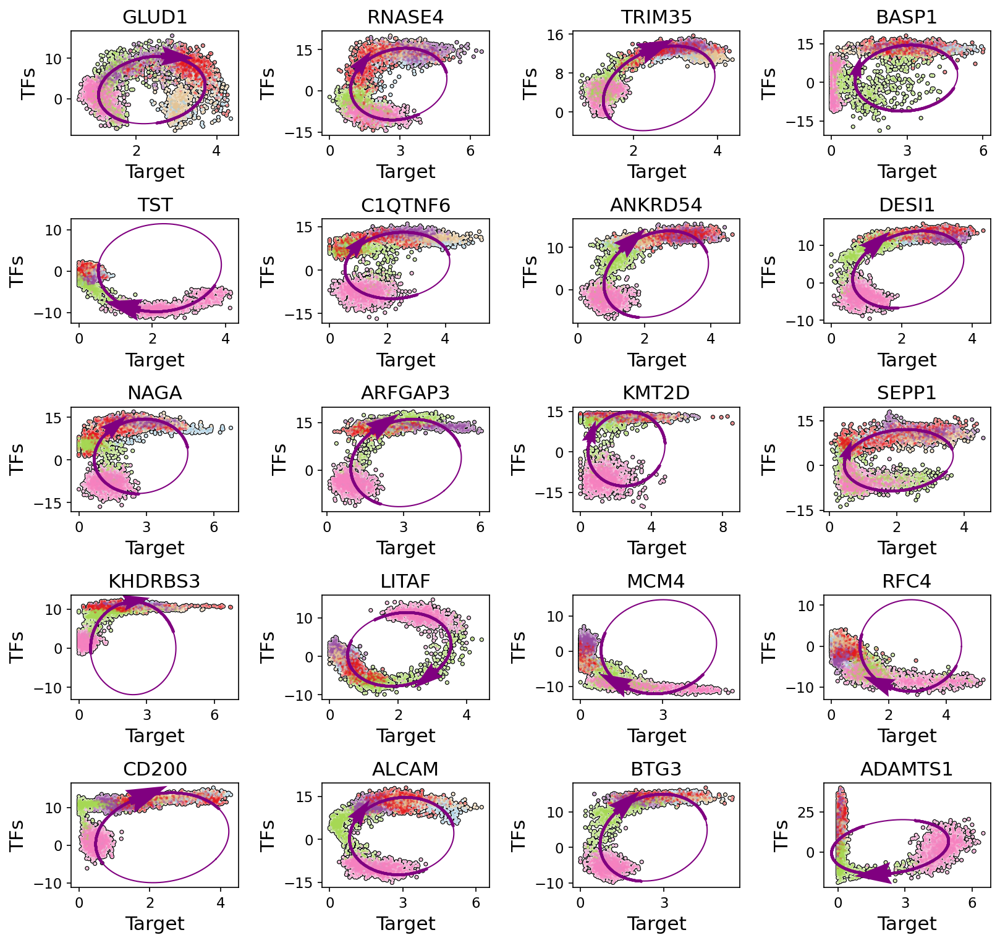

...

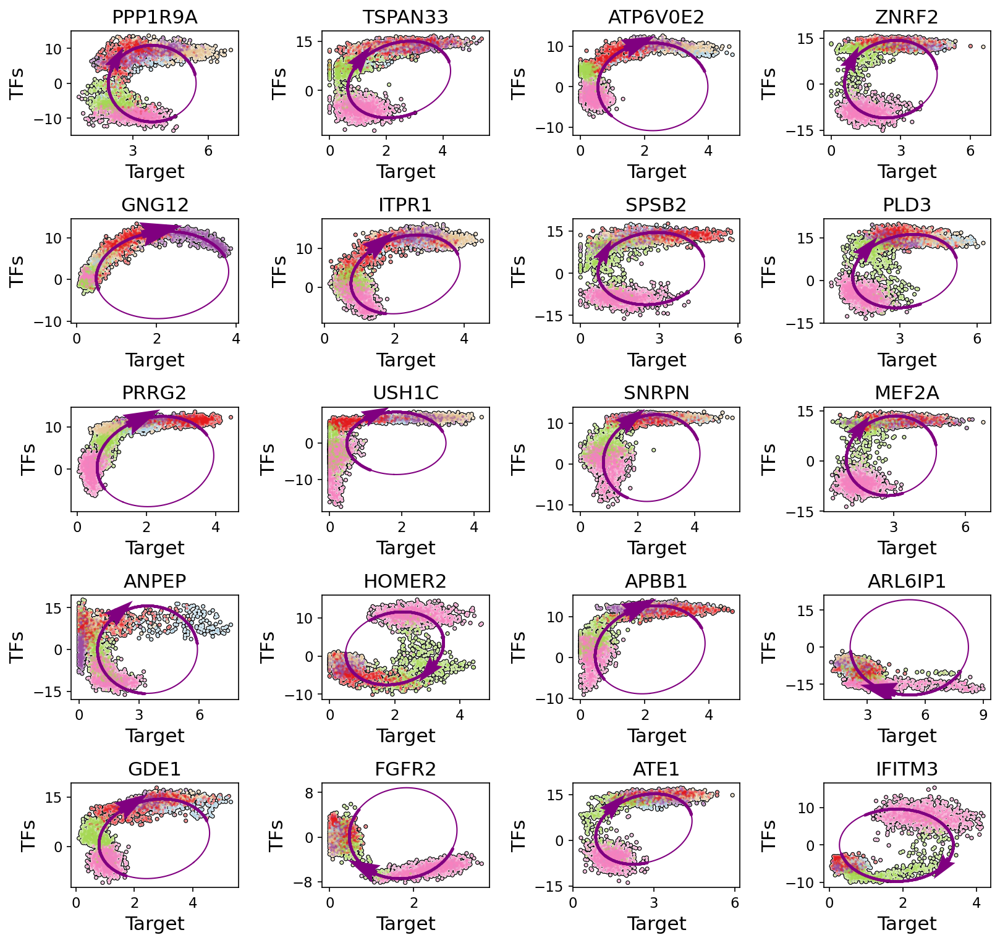

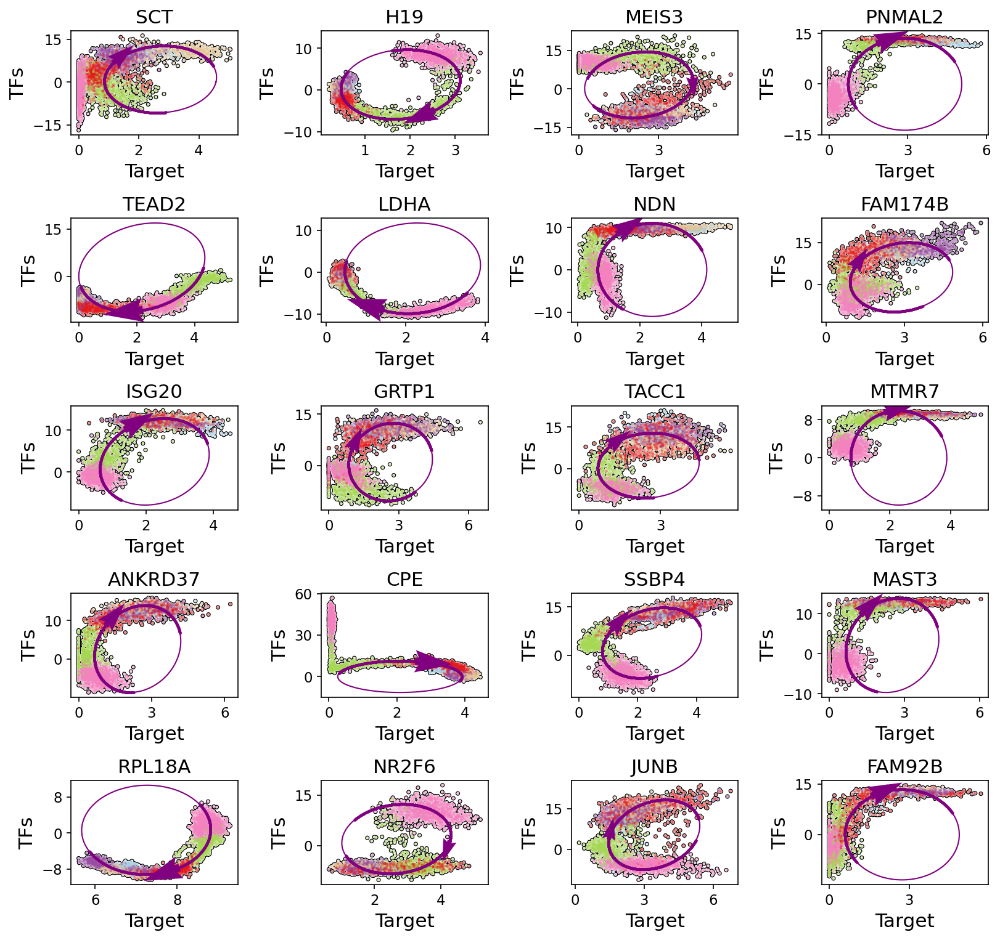

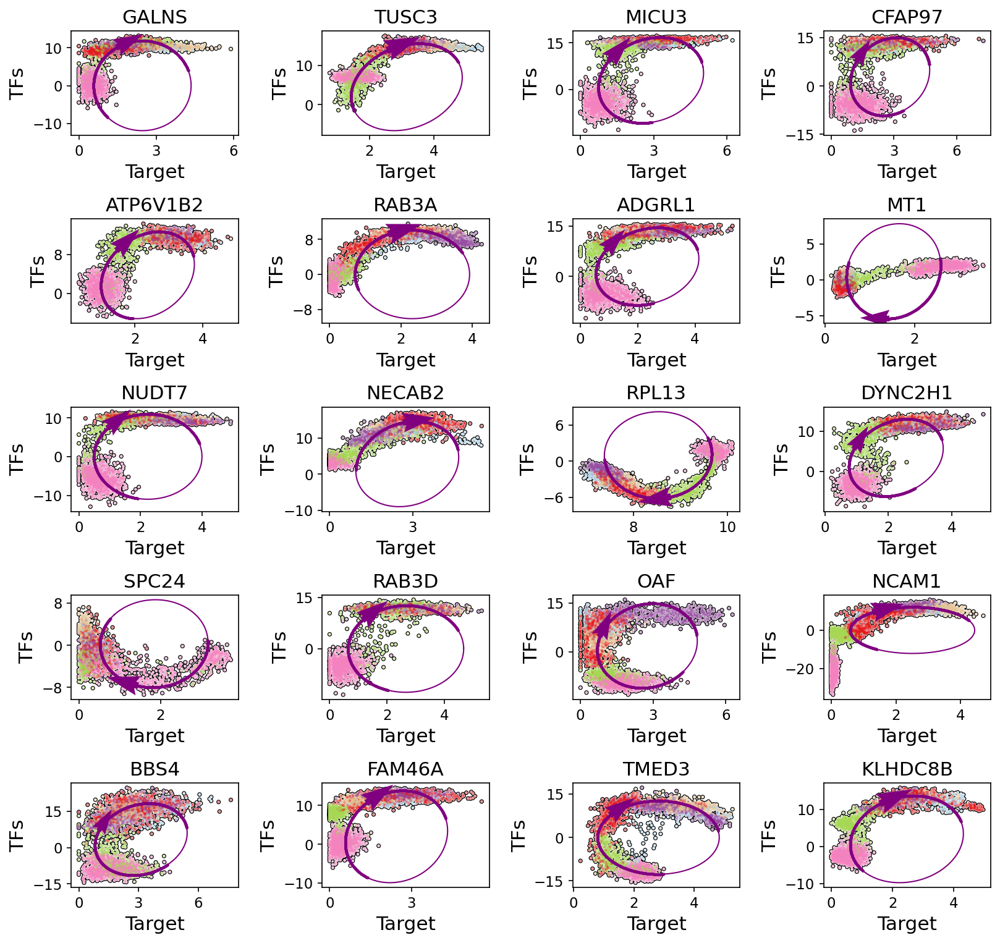

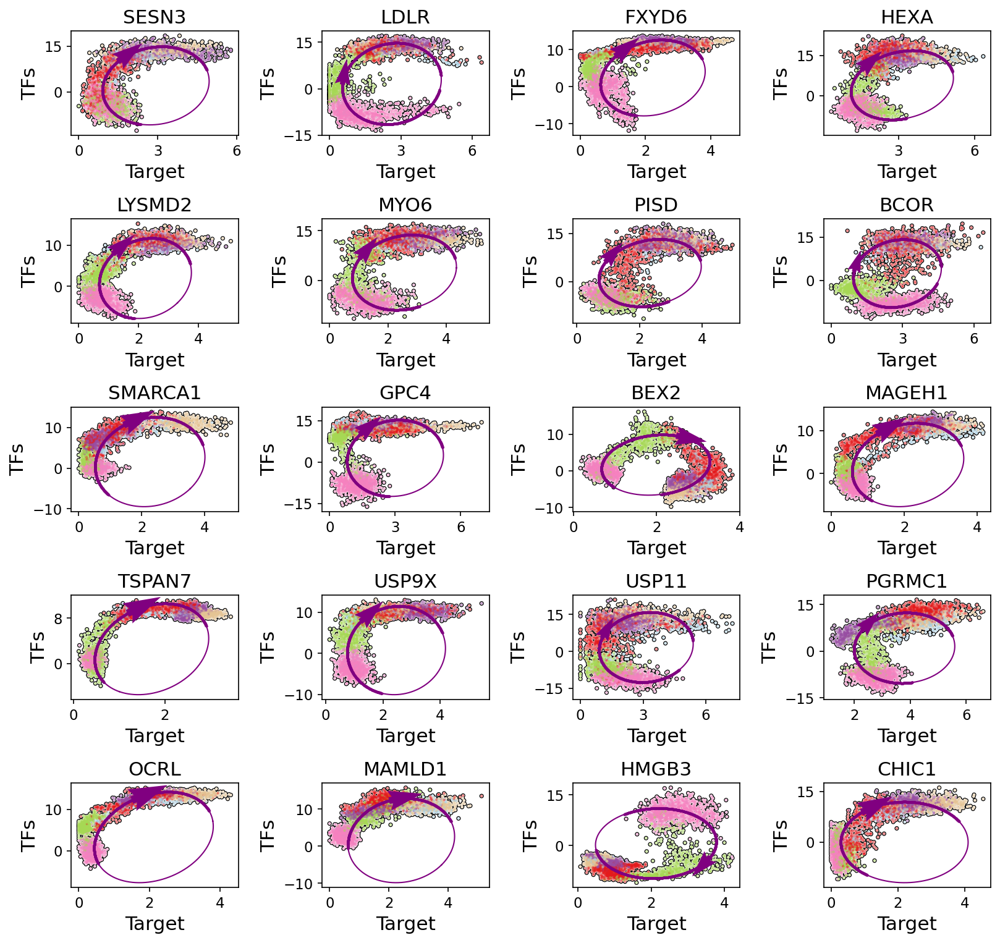

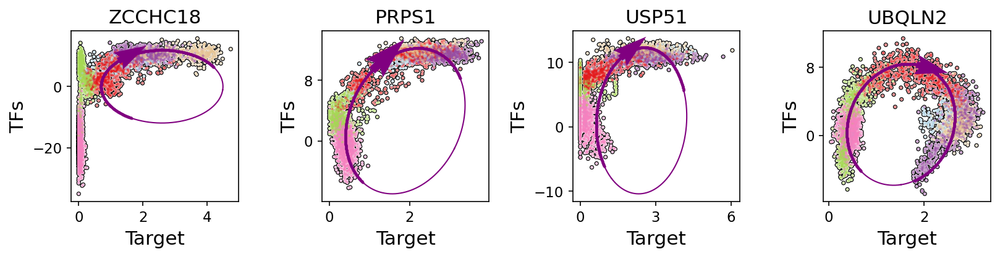

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


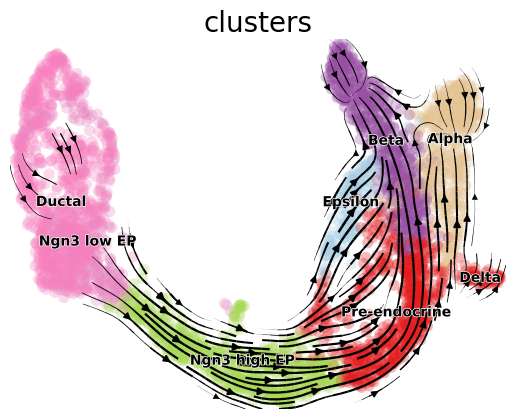

In [281]:
TFv.tl.velocity_graph(adata_copy2, basis=None, vkey='velocity', xkey='M_total')
adata_copy2.uns['clusters_colors'] = adata.uns['clusters_colors']
show_adata(adata_copy2, save_name='velo', show_all=1)

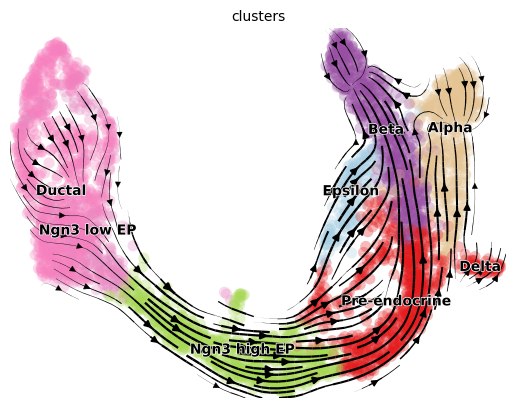

In [285]:
scv.pl.velocity_embedding_stream(adata_copy2, vkey='velocity', basis='umap', color='clusters')

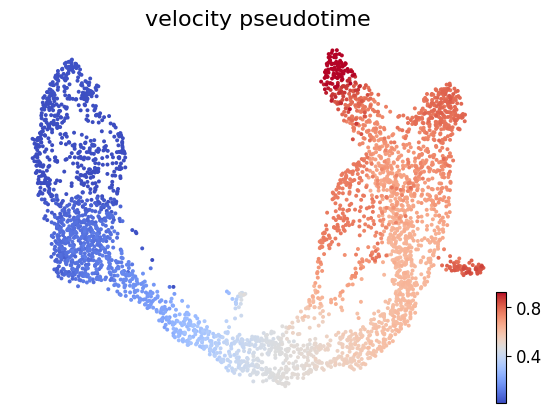

In [292]:
scv.pl.scatter(adata_copy2, color='velocity_pseudotime', 
               fontsize=16, 
               color_map=['coolwarm'], 
               perc=[2, 98])

In [294]:
adata_copy2.var_names

Index(['NCOA2', 'UGGT1', 'FEV', 'CHPF', 'DTYMK', 'PAM', 'TROVE2', 'SOAT1',
       'MGST3', 'PEA15A',
       ...
       'USP11', 'PGRMC1', 'OCRL', 'MAMLD1', 'HMGB3', 'CHIC1', 'ZCCHC18',
       'PRPS1', 'USP51', 'UBQLN2'],
      dtype='object', length=284)

In [299]:
import seaborn as sns
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'WX_SURF4')

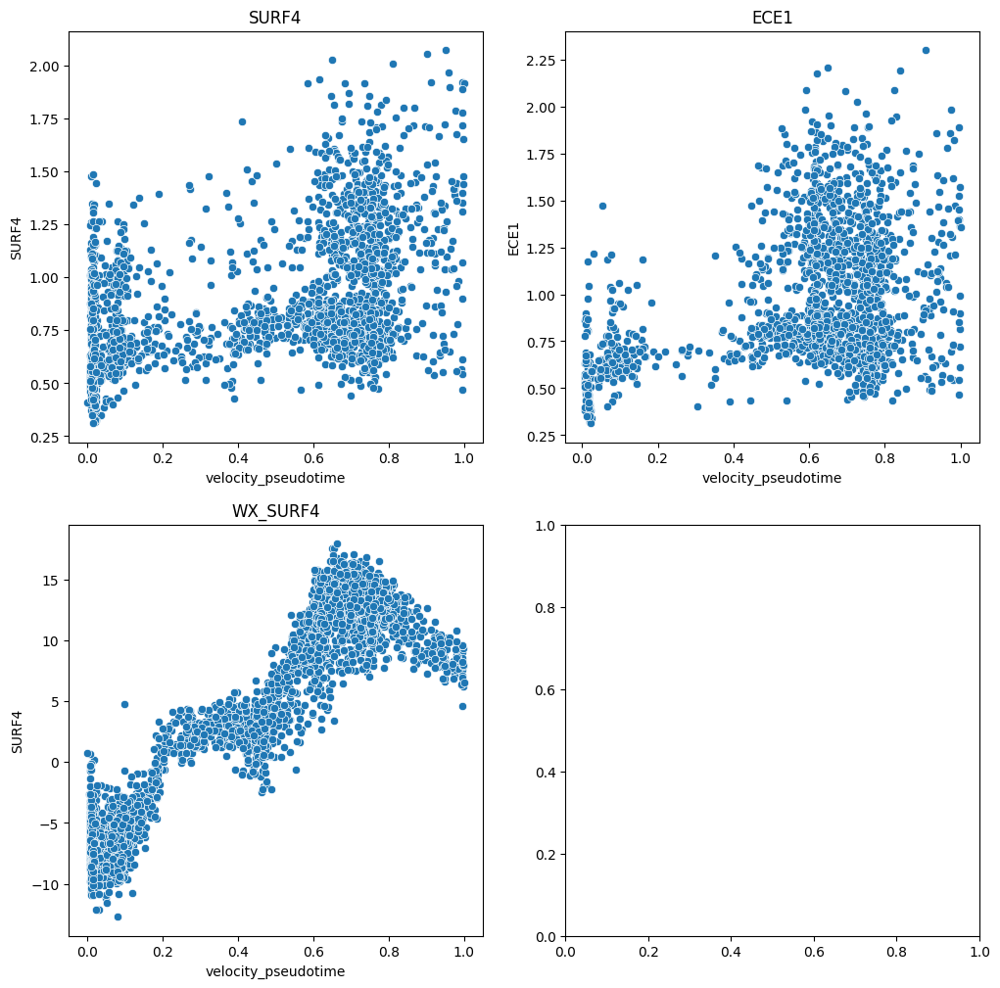

In [318]:
figs90a = plt.figure(figsize=(12, 12))
(ax1, ax2), (ax3, ax4) = figs90a.subplots(2, 2)

TF_time_dependent = 'SURF4'
df_surf4 = pd.concat([pd.DataFrame(adata_copy2[:, [TF_time_dependent]].X.toarray(), index=adata_copy2.obs_names, columns=[TF_time_dependent]), adata_copy2.obs['velocity_pseudotime']], axis=1)
sns.scatterplot(data=df_surf4[df_surf4[TF_time_dependent] > 0], x='velocity_pseudotime', y=TF_time_dependent, ax=ax1)
ax1.set_title(TF_time_dependent)

TF_time_dependent = 'ECE1'
df_surf4 = pd.concat([pd.DataFrame(adata_copy2[:, [TF_time_dependent]].X.toarray(), index=adata_copy2.obs_names, columns=[TF_time_dependent]), adata_copy2.obs['velocity_pseudotime']], axis=1)
sns.scatterplot(data=df_surf4[df_surf4[TF_time_dependent] > 0], x='velocity_pseudotime', y=TF_time_dependent, ax=ax2)
ax2.set_title(TF_time_dependent)

TF_time_dependent = 'SURF4'
df_surf4 = pd.concat([pd.DataFrame(adata_copy2[:, [TF_time_dependent]].layers['WX'].toarray(), index=adata_copy2.obs_names, columns=[TF_time_dependent]), adata_copy2.obs['velocity_pseudotime']], axis=1)
sns.scatterplot(data=df_surf4, x='velocity_pseudotime', y=TF_time_dependent, ax=ax3)
ax3.set_title('WX_' + TF_time_dependent)


In [309]:
adata_copy2.layers['WX'].shape

(3696, 284)

In [326]:
adata1.varm

AxisArrays with keys: TFs, TFs_id, TFs_times, TFs_correlation, knockTF_Log2FC, fit_scaling, fit_weights, fit_weights_init, fit_weights_final, loss

In [332]:
adata1.varm['TFs']

array([['EGR1', 'FOXA2', 'ATF3', ..., 'blank', 'blank', 'blank'],
       ['HMGN3', 'JUND', 'blank', ..., 'blank', 'blank', 'blank'],
       ['FOXA2', 'ATF3', 'REST', ..., 'blank', 'blank', 'blank'],
       ...,
       ['FOS', 'STAT3', 'E2F1', ..., 'blank', 'blank', 'blank'],
       ['REST', 'MXI1', 'MAFF', ..., 'blank', 'blank', 'blank'],
       ['REST', 'blank', 'blank', ..., 'blank', 'blank', 'blank']],
      dtype='<U5')

In [337]:
sorted(list(set(adata1.varm['TFs'].flatten())))

['ATF3',
 'AUTS2',
 'BACH1',
 'BCOR',
 'CCND1',
 'CDX2',
 'CHD7',
 'CREM',
 'DACH1',
 'E2F1',
 'EGR1',
 'ETV1',
 'EZH2',
 'FOS',
 'FOXA2',
 'FOXO1',
 'FOXO3',
 'FOXP1',
 'FOXP2',
 'HMGN3',
 'ISL1',
 'JARID',
 'JUND',
 'KLF2',
 'KLF4',
 'KLF6',
 'MAFF',
 'MEF2A',
 'MNX1',
 'MXI1',
 'NEURO',
 'NFIB',
 'NR4A2',
 'PAX6',
 'PDX1',
 'POU3F',
 'PRDM1',
 'RAC3',
 'RCOR2',
 'REST',
 'SMC4',
 'SOX11',
 'SOX9',
 'SRF',
 'STAT3',
 'VDR',
 'blank']